In [1]:
import cv2
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json
import matplotlib.patches as patches

In [2]:
data_dir = "../../dataset/mcocr_public_train_test_shared_data"
train_dir = f"{data_dir}/mcocr_train_data"
val_dir = f"{data_dir}/mcocr_val_data"

In [3]:
print("Number of training images: ", len(os.listdir(os.path.join(train_dir, "train_images"))))

Number of training images:  1156


In [4]:
print("Number of public test images: ", len(os.listdir(os.path.join(val_dir, "val_images"))))

Number of public test images:  392


In [5]:
with open(f"{data_dir}/label_dict.json") as file:
    idx2name = json.load(file)

In [6]:
train_anns = pd.read_csv(f"{train_dir}/mcocr_train_df.csv")

In [7]:
train_anns["ADDRESS"] = 0
train_anns["SELLER"] = 0
train_anns["TIMESTAMP"] = 0
train_anns["TOTAL_COST"] = 0
for i, row in train_anns.iterrows():
    ann_labels = row["anno_labels"]
    if (row["anno_num"] == 0):
        continue
    k, v = np.unique(ann_labels.split("|||"), return_counts=True)
    for j, item in enumerate(k):
        train_anns.at[i, item] = v[j]

In [8]:
train_anns

,img_id,anno_polygons,anno_texts,anno_labels,anno_num,anno_image_quality,ADDRESS,SELLER,TIMESTAMP,TOTAL_COST,TOTAL_TOTAL_COST
0,mcocr_public_145013ddcph.jpg,"[{'category_id': 15, 'segmentation': [[231.9, ...",MINIMART ANAN|||Chợ Sủi Phú Thị Gia Lâm|||Ngày...,SELLER|||ADDRESS|||TIMESTAMP|||TOTAL_COST|||TO...,5,0.635309,1,1,1,2,NaN
1,mcocr_public_145013fxcgs.jpg,"[{'category_id': 15, 'segmentation': [[311.6, ...",VinCommerce|||VM + QNH Dự án quỹ đất đường sắt...,SELLER|||ADDRESS|||ADDRESS|||ADDRESS|||TIMESTA...,7,0.774317,3,1,1,2,NaN
2,mcocr_public_145013clltn.jpg,"[{'category_id': 15, 'segmentation': [[626.8, ...",SIEU THI BACH HOA TONG HOP|||Bố 5 Cẩm Tây - Cẩ...,SELLER|||ADDRESS|||TOTAL_COST|||TOTAL_COST|||T...,5,0.664084,1,1,0,3,NaN
3,mcocr_public_145013tmibr.jpg,"[{'category_id': 15, 'segmentation': [[715.5, ...",co.op mart|||Co.opMart HAU GIANG|||188 Hau Gia...,SELLER|||SELLER|||ADDRESS|||ADDRESS|||TIMESTAM...,8,0.715504,2,2,2,2,NaN
4,mcocr_public_145013kgypr.jpg,"[{'category_id': 16, 'segmentation': [[200.5, ...","Tổ 7, Khu Minh Tiến A|||VinCommerce|||Ngày bán...",ADDRESS|||SELLER|||TIMESTAMP|||TOTAL_COST|||TO...,5,0.766884,1,1,1,2,NaN
...,...,...,...,...,...,...,...,...,...,...,...
1150,mcocr_public_145014dhito.jpg,"[{'category_id': 15, 'segmentation': [[248.7, ...",MINIMART ANAN|||Chợ Sủi Phú Thị Gia Lâm|||Ngày...,SELLER|||ADDRESS|||TIMESTAMP|||TOTAL_COST|||TO...,5,0.748317,1,1,1,2,NaN
1151,mcocr_public_145014bokrq.jpg,"[{'category_id': 15, 'segmentation': [[144.3, ...",VinCommerce|||VM+QNH Tổ 8 Khu 3B Cẩm Trung|||T...,SELLER|||ADDRESS|||ADDRESS|||ADDRESS|||TIMESTA...,7,0.675324,3,1,1,2,NaN
1152,mcocr_public_145014ectxq.jpg,"[{'category_id': 15, 'segmentation': [[255.7, ...",VinCommerce|||VM+ QNH 112 Thanh Niên|||Số 112 ...,SELLER|||ADDRESS|||ADDRESS|||ADDRESS|||TIMESTA...,7,0.708228,3,1,1,2,NaN
1153,mcocr_public_145014xyzwl.jpg,"[{'category_id': 15, 'segmentation': [[218.6, ...",VinCommerce|||VM+ QNH 580 Trần phú|||Số 590 Tr...,SELLER|||ADDRESS|||ADDRESS|||ADDRESS|||TIMESTA...,7,0.650219,3,1,1,2,NaN


In [9]:
color_map = {1: (255, 0, 0), 15: (0, 255, 0), 16: (0, 0, 255), 17: (255, 0, 255), 18: (0, 255, 255)}
txt_color_map = {1: 'r', 15: 'green', 16: 'blue', 17: 'm', 18: 'cyan'}

def my_visualize(img_dir, file_name, train_anns, add_key_to_value=False):
    info_df = train_anns.loc[train_anns["img_id"] == file_name].iloc[0]
    img = cv2.imread(f"{img_dir}/{file_name}")
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    print(file_name)
    num_polygons, quality = int(info_df[4]), info_df[5]
    if (int(num_polygons) > 0):
        annotation = eval(info_df[1])
        key, value = info_df[3].split("|||"), info_df[2].split("|||")
        index_dict = {
            1: 0,
            15: 0,
            16: 0,
            17: 0,
            18: 0
        }
        plt.figure(figsize=(20, 20))
        for i, ann in enumerate(annotation):
            polygons = []
            for item in ann["segmentation"]:
                polygons.append(np.array(item, dtype=np.int32).reshape(-1, 2))
            box = np.array(ann["bbox"])
            box[2:] = box[:2] + box[2:]
            category_id = ann["category_id"]
            text = f"{value[i]}|{key[i]}_{index_dict[category_id]}" if (add_key_to_value) else f"{value[i]}"
            if (add_key_to_value):
                index_dict[category_id] += 1
            img = cv2.polylines(img, polygons, True, color_map[category_id], thickness=2)
            plt.text(box[2] + 5, box[3] - 10, text, fontsize=20,
                 fontdict={"color": "r"})
            # img = cv2.putText(img, text, (box[0] + 5, box[3]), cv2.FONT_HERSHEY_SIMPLEX, 1, txt_color_map[category_id], 2, cv2.LINE_AA)
    plt.imshow(img)
    plt.axis("off")
    plt.show()
    

mcocr_public_145013bfddt.jpg


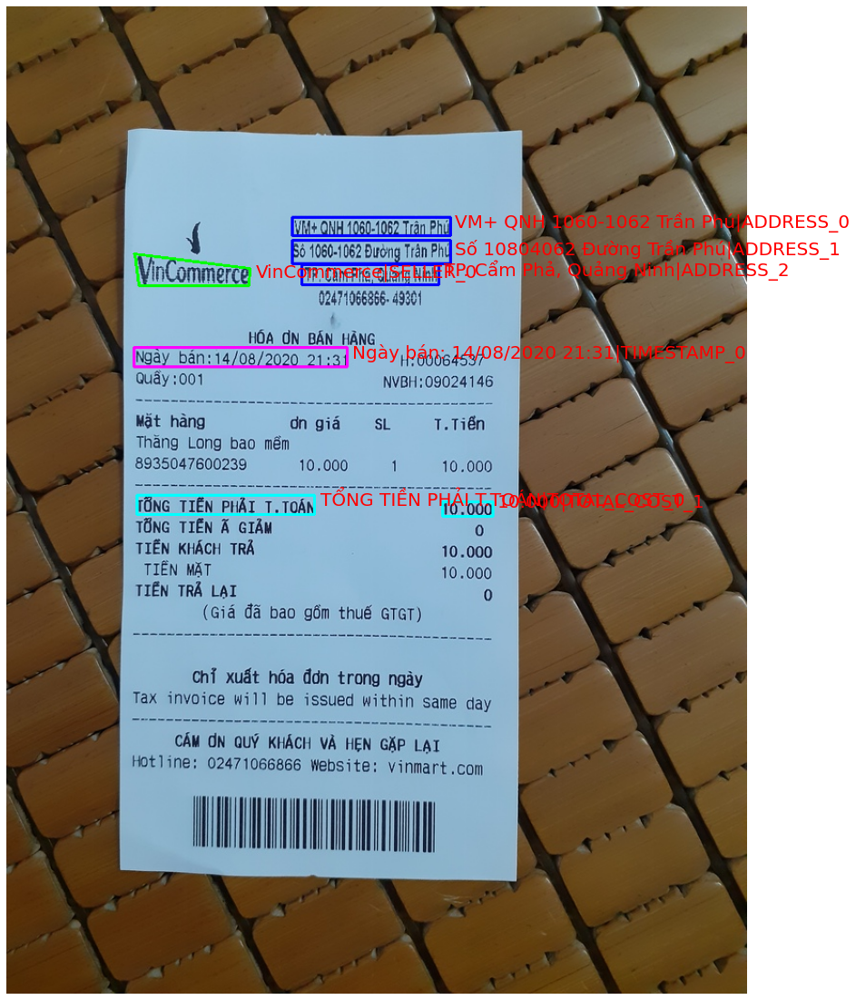

mcocr_public_145014vnfrc.jpg


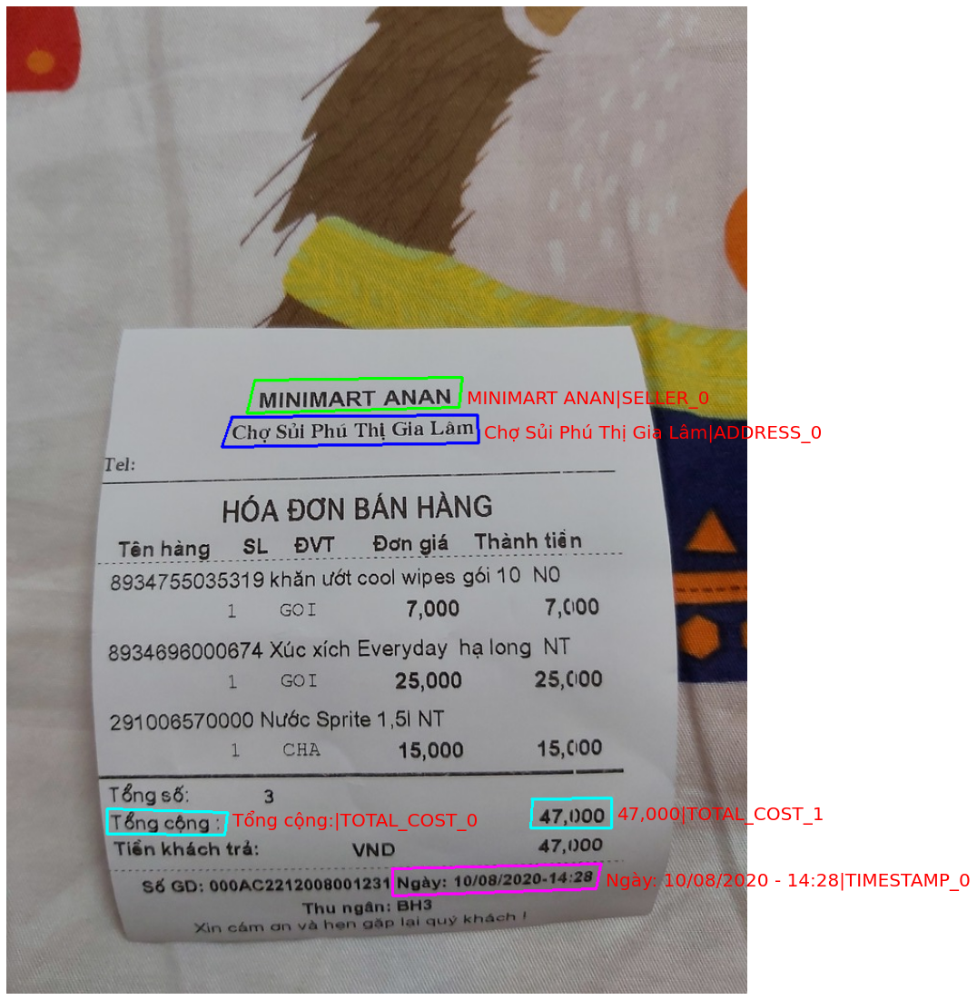

mcocr_public_145014rvwat.jpg


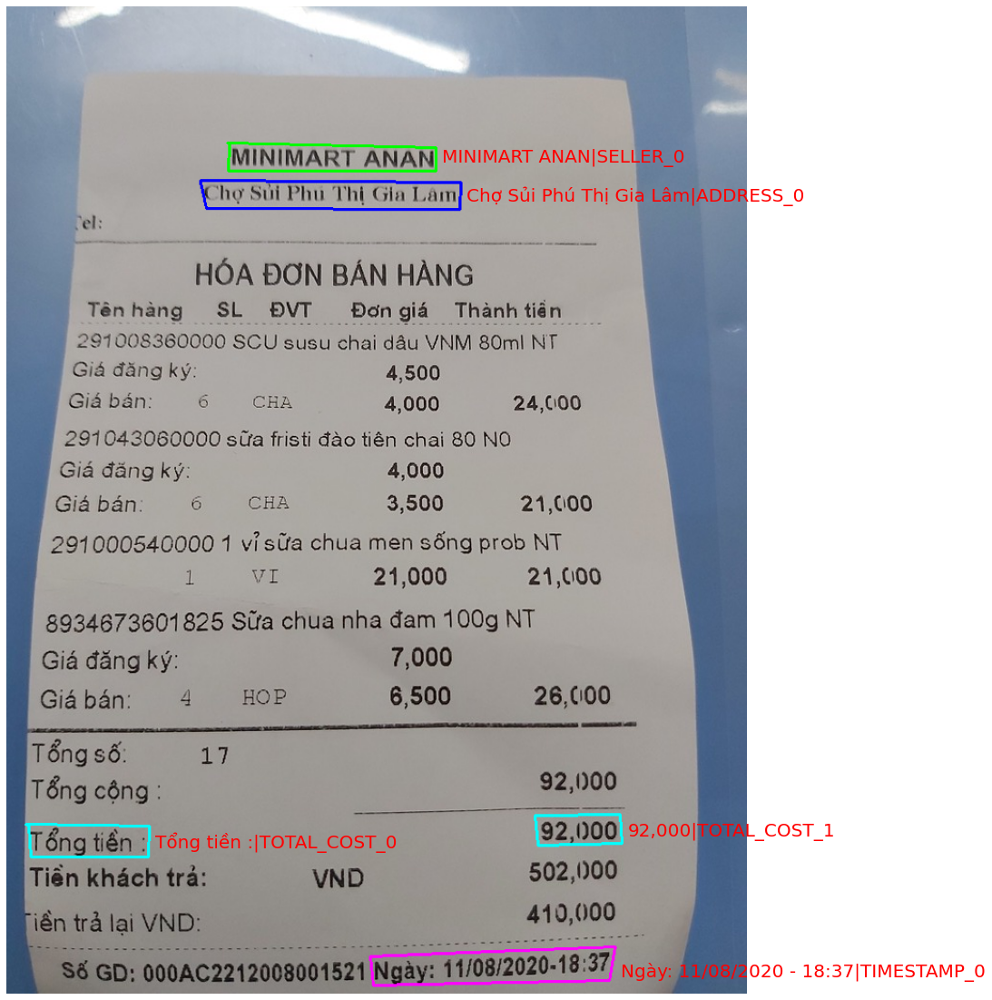

mcocr_public_145013nsnnh.jpg


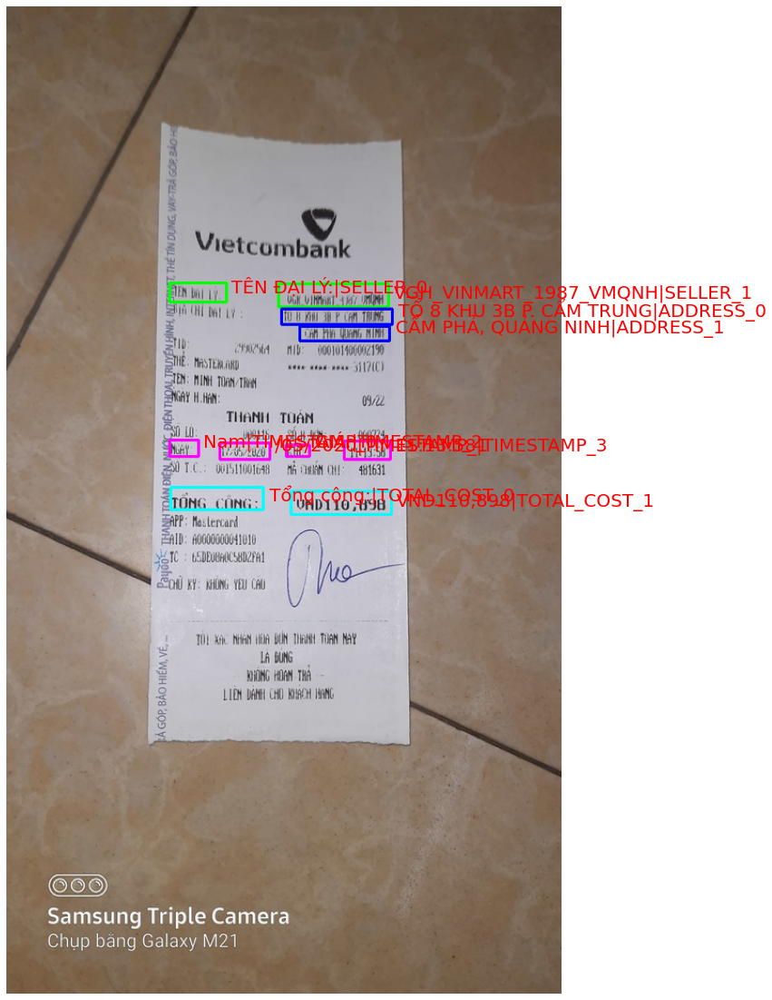

mcocr_public_145014yngbg.jpg


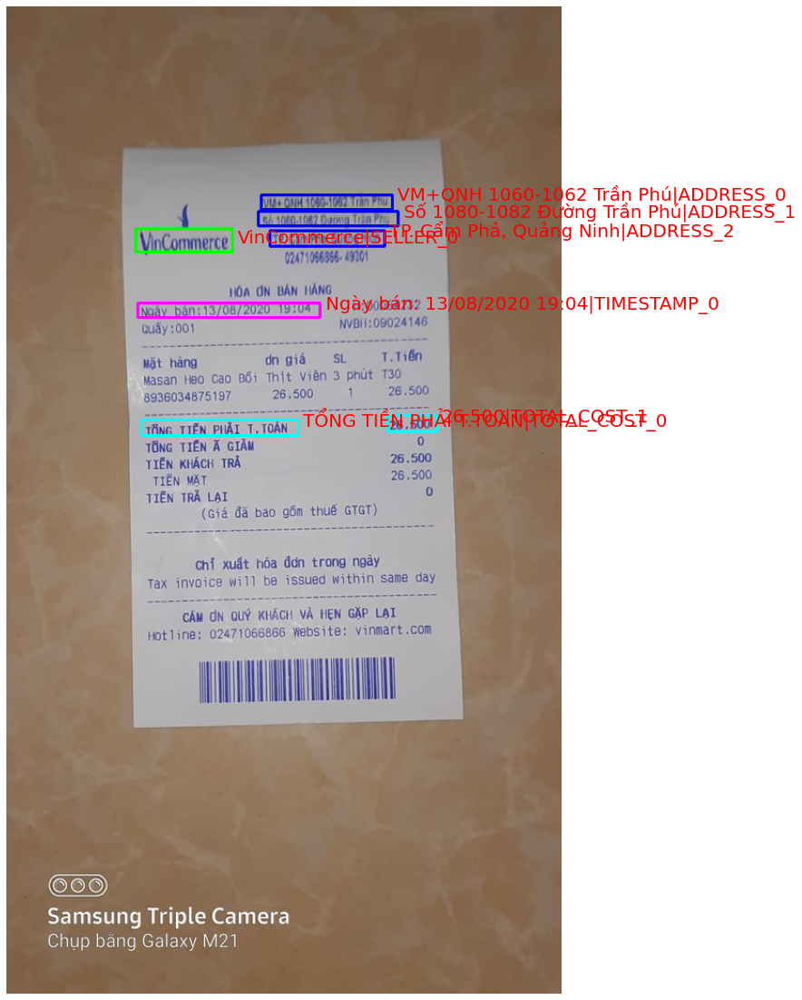

mcocr_public_145014dwyzl.jpg


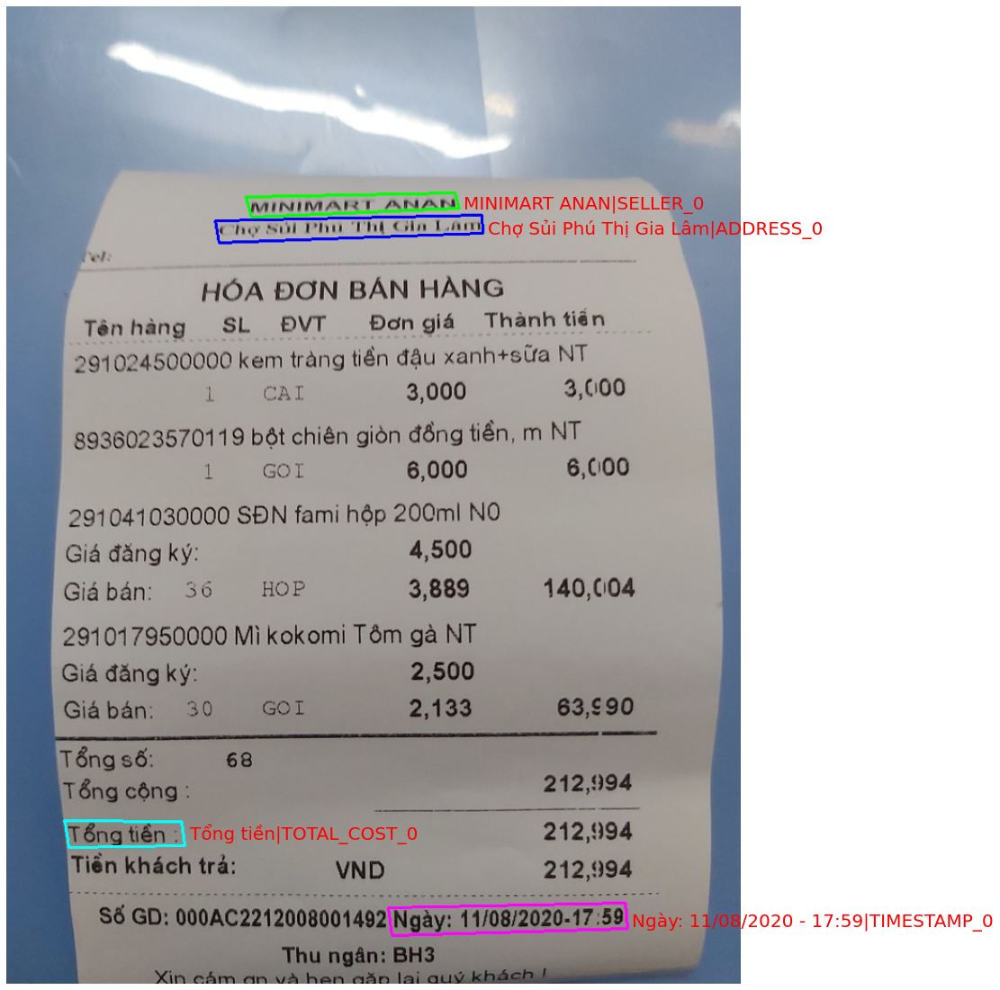

mcocr_public_145014xkuxu.jpg


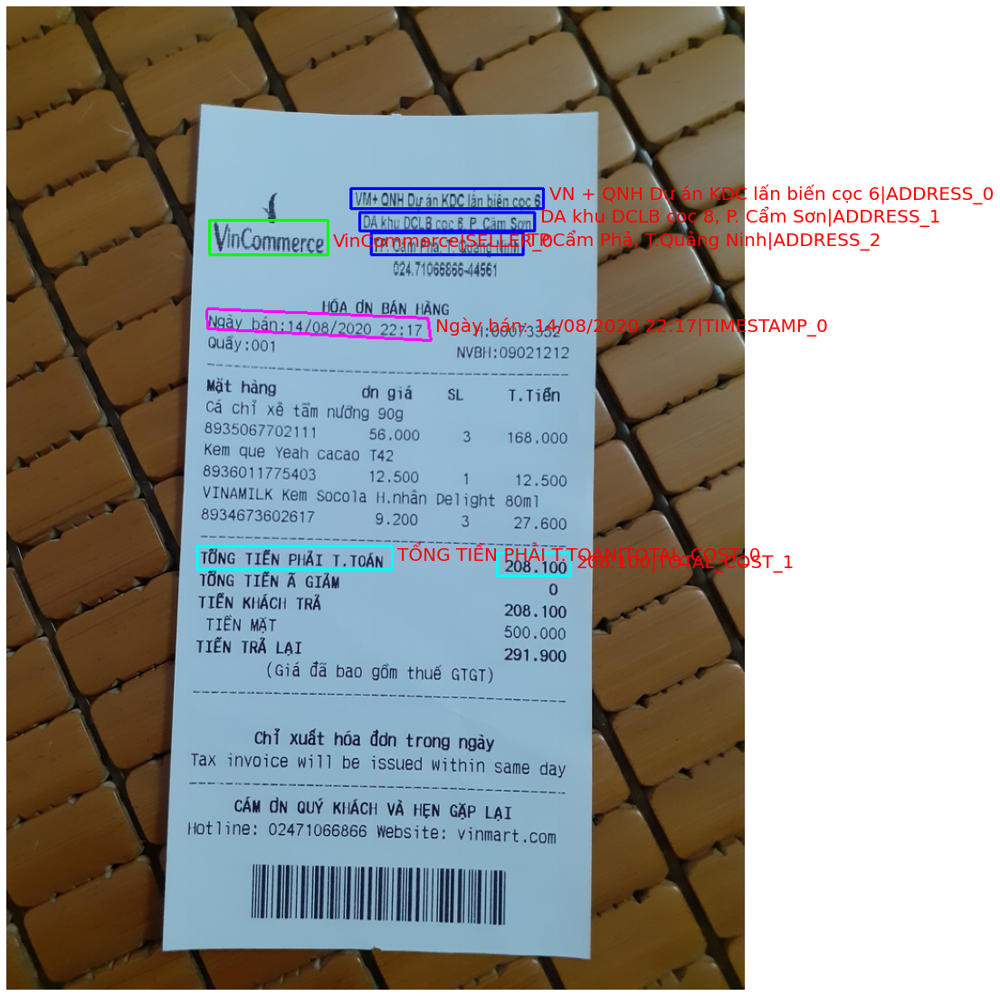

mcocr_public_145013atnil.jpg


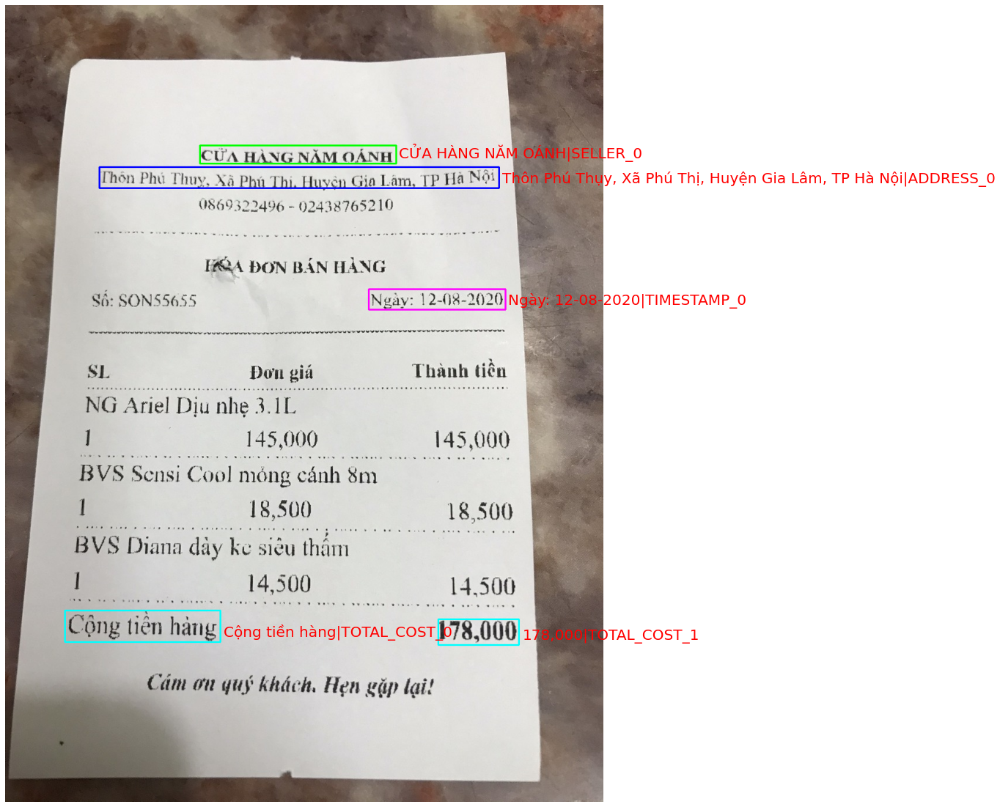

mcocr_public_145014gobum.jpg


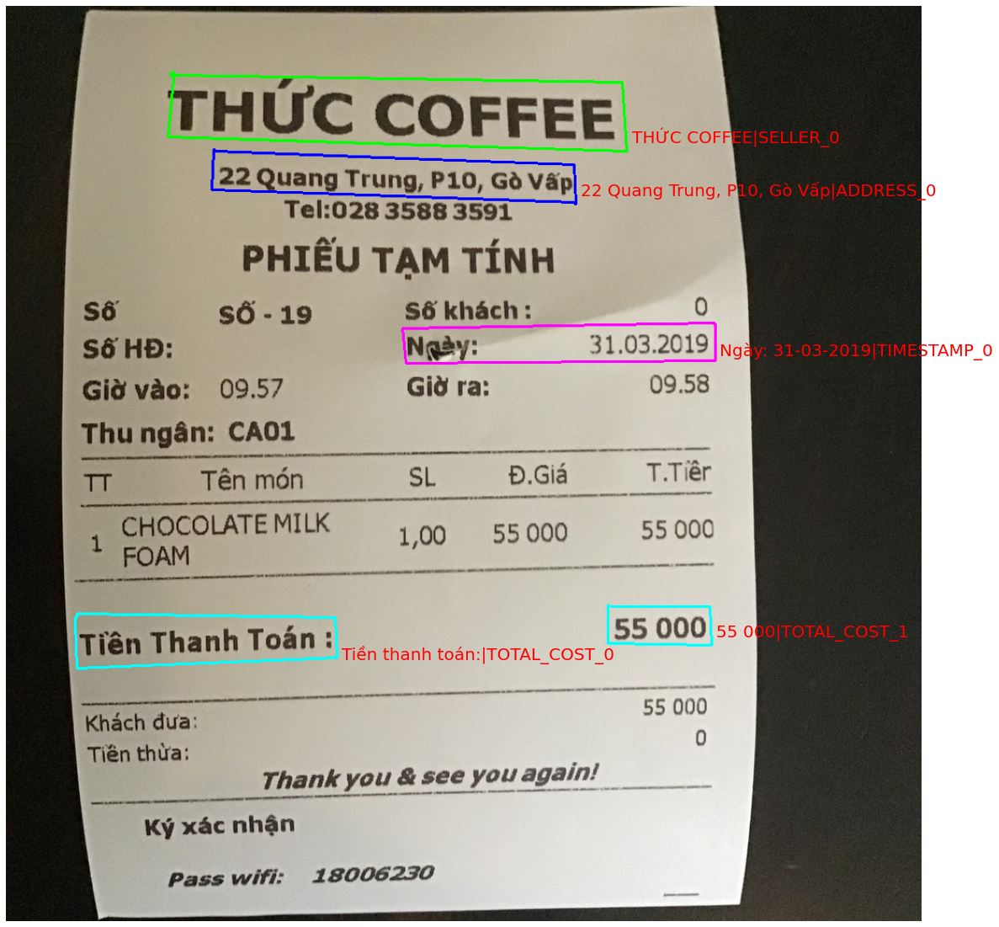

mcocr_public_145014skzzh.jpg


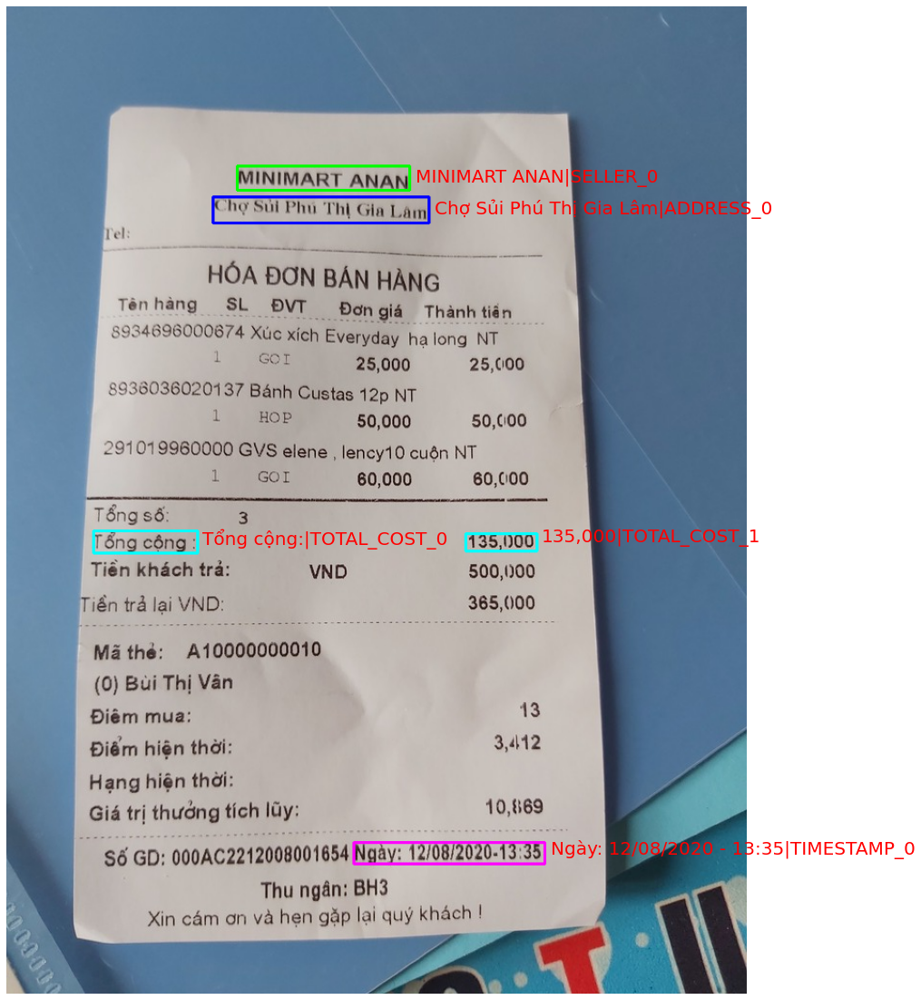

In [10]:
examples = np.random.choice(os.listdir(f"{train_dir}/train_images"), size=10, replace=False)
for file_name in examples:
    my_visualize(f"{train_dir}/train_images", file_name, train_anns, add_key_to_value=True)

In [11]:
train_anns["anno_num"].describe()

count    1155.000000
mean        5.701299
std         1.826046
min         0.000000
25%         5.000000
50%         5.000000
75%         7.000000
max        29.000000
Name: anno_num, dtype: float64

Files without annotation: 
mcocr_public_145014iwhec.jpg


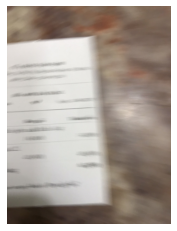

mcocr_public_145014jndnz.jpg


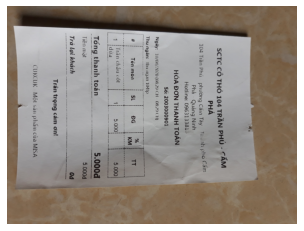

In [12]:
zero_examples = train_anns.loc[train_anns["anno_num"] == 0]["img_id"].values
print("Files without annotation: ")
for file_name in zero_examples:
    my_visualize(f"{train_dir}/train_images", file_name, train_anns, add_key_to_value=True)

mcocr_public_145014mwhyh.jpg


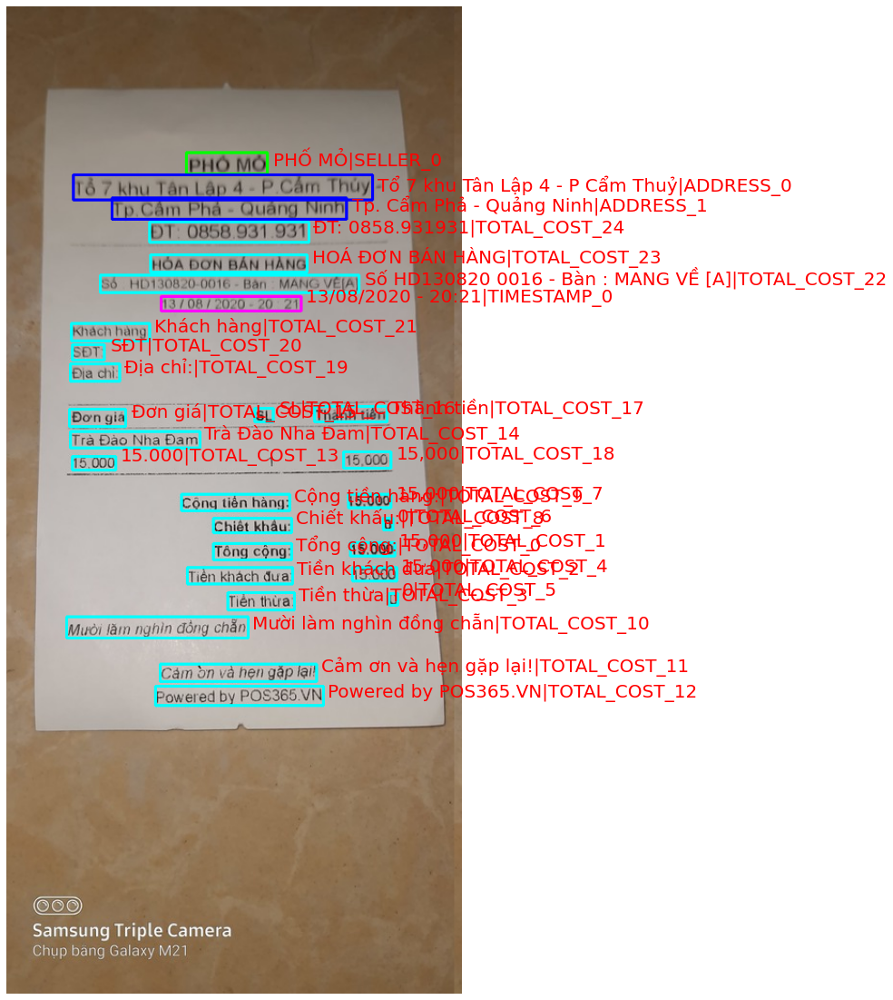

mcocr_public_145013clltn.jpg


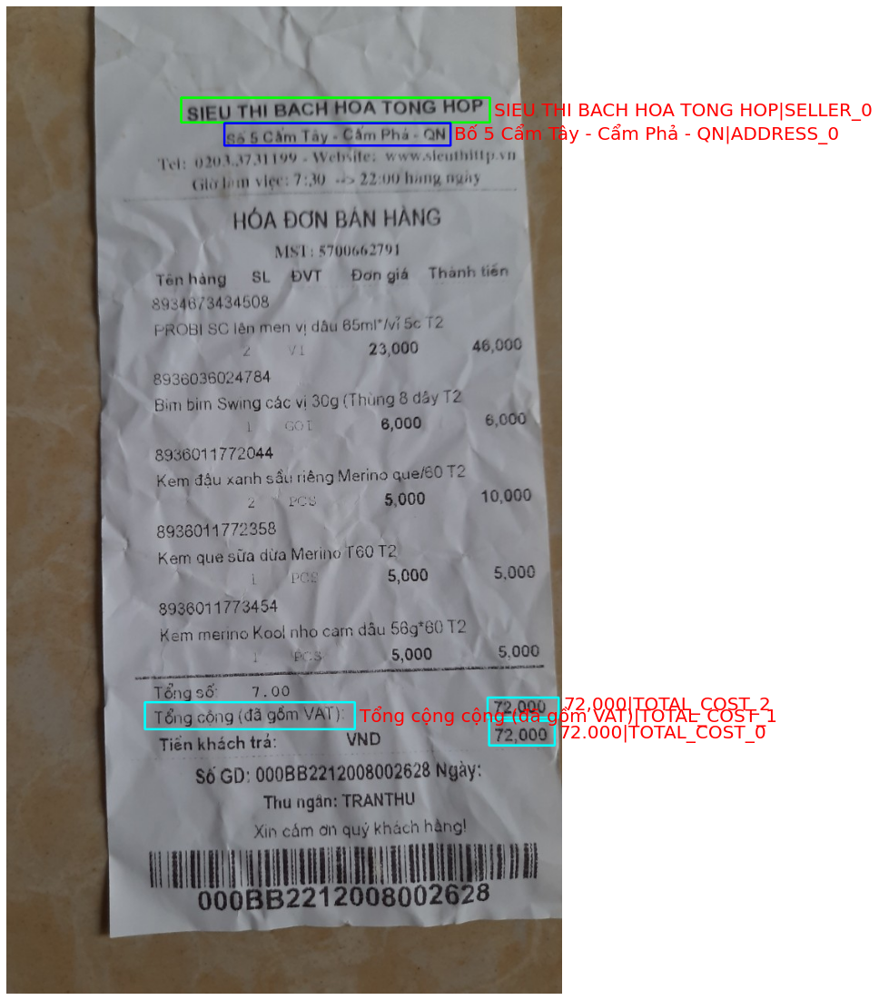

mcocr_public_145013uqtmx.jpg


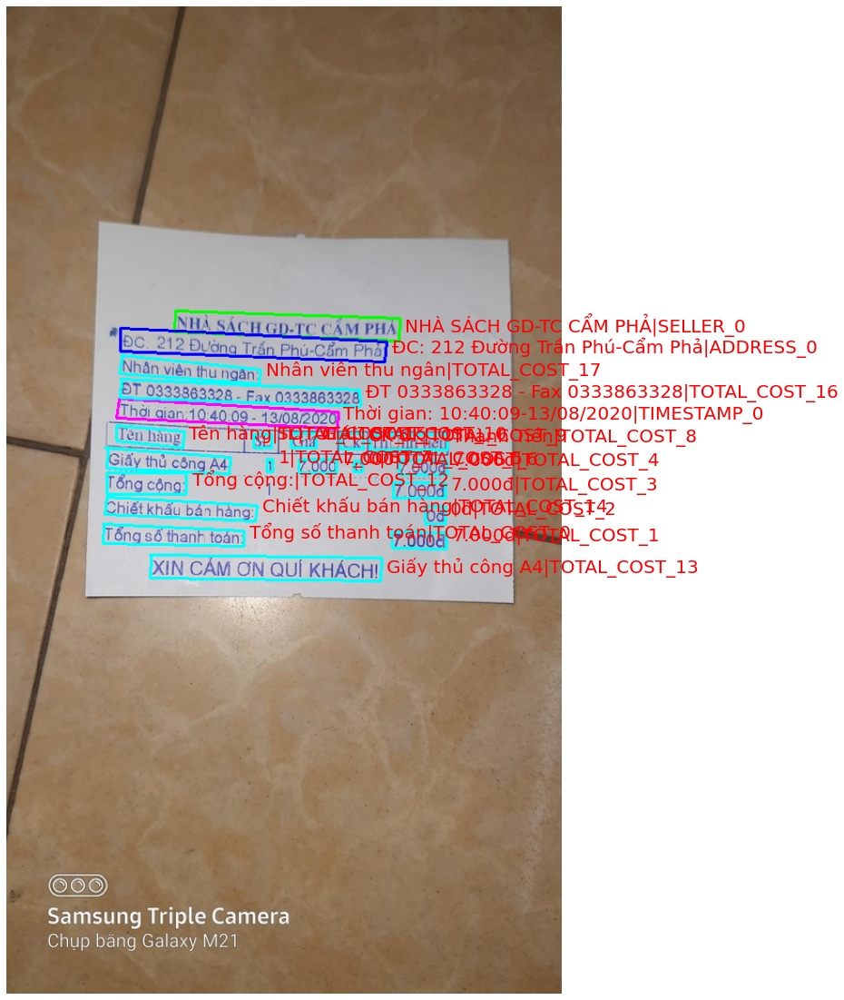

mcocr_public_145013cgpoh.jpg


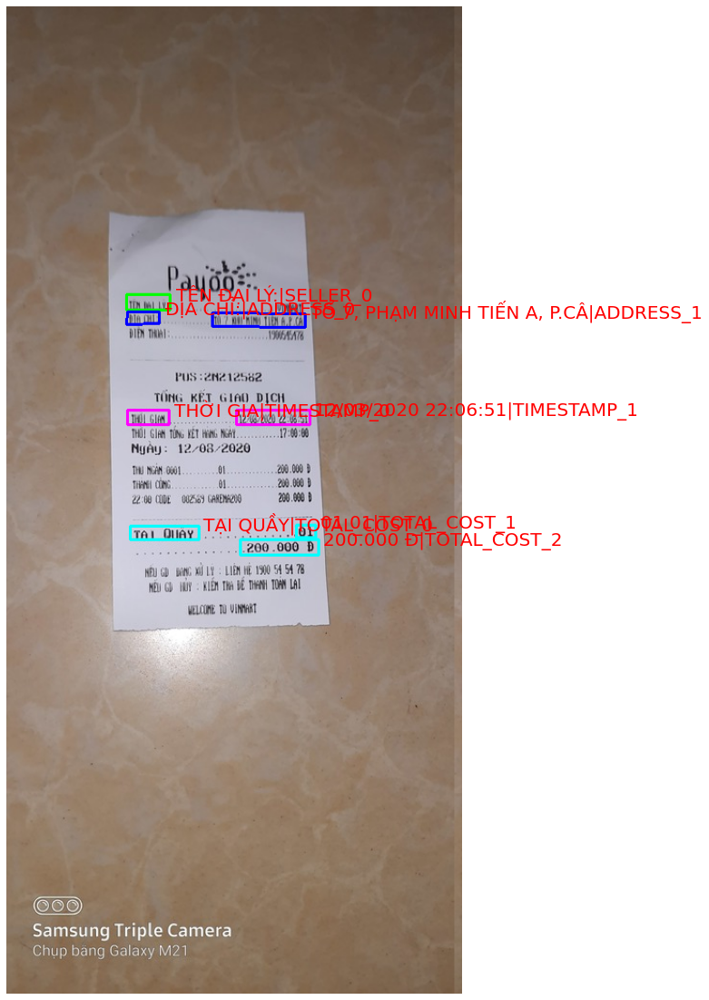

mcocr_public_145014jizcq.jpg


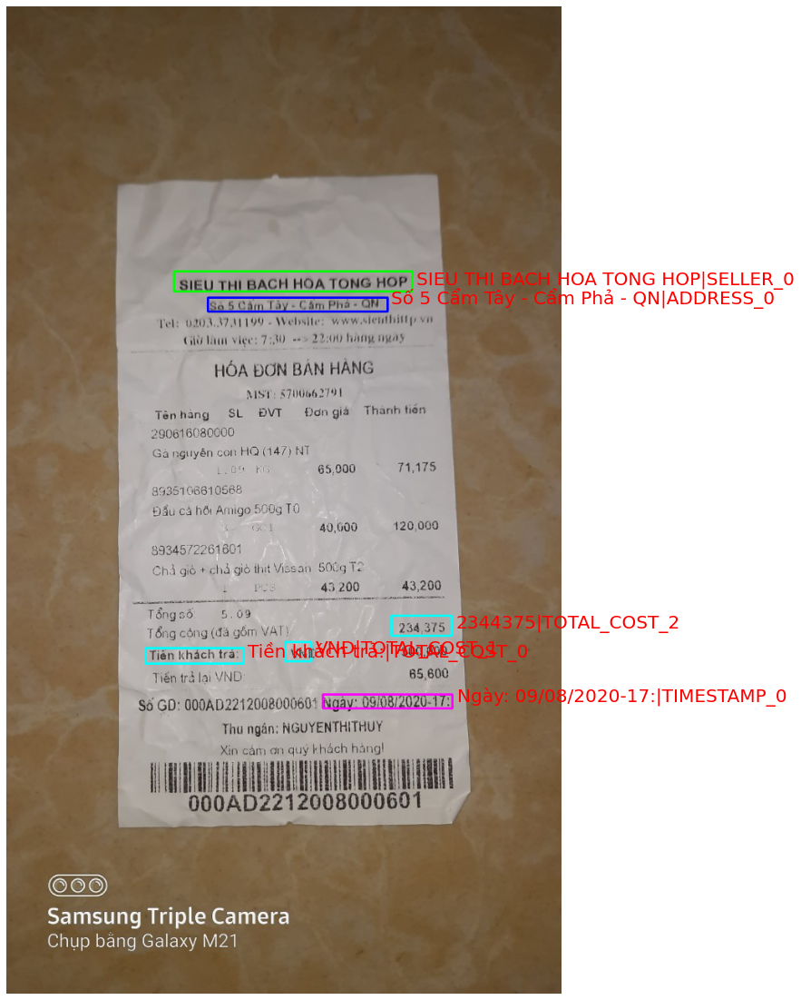

mcocr_public_145014mwhyh.jpg


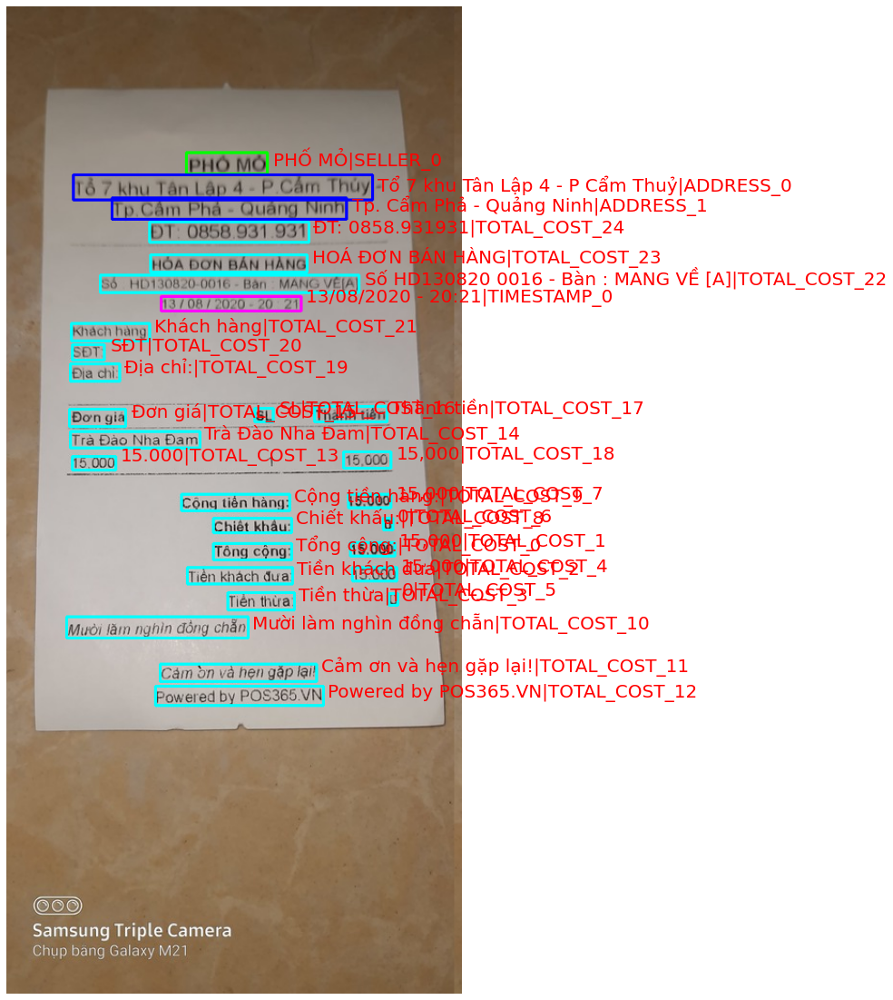

mcocr_public_145014sabav.jpg


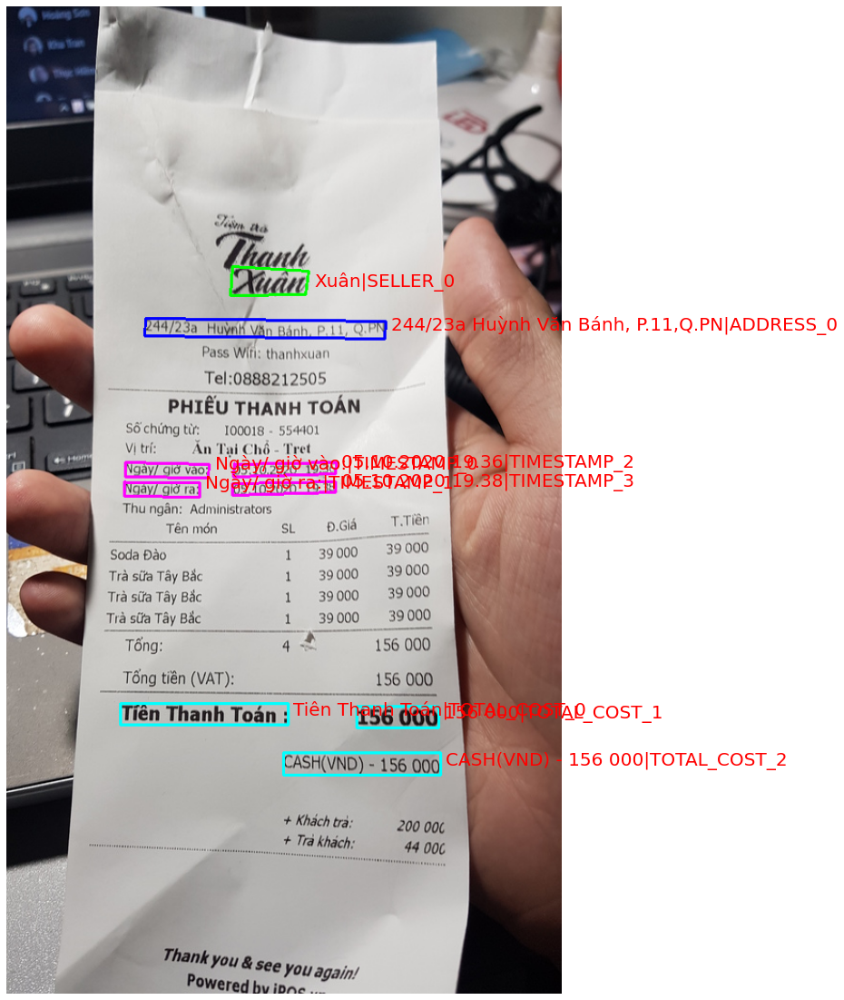

mcocr_public_145014hpkhf.jpg


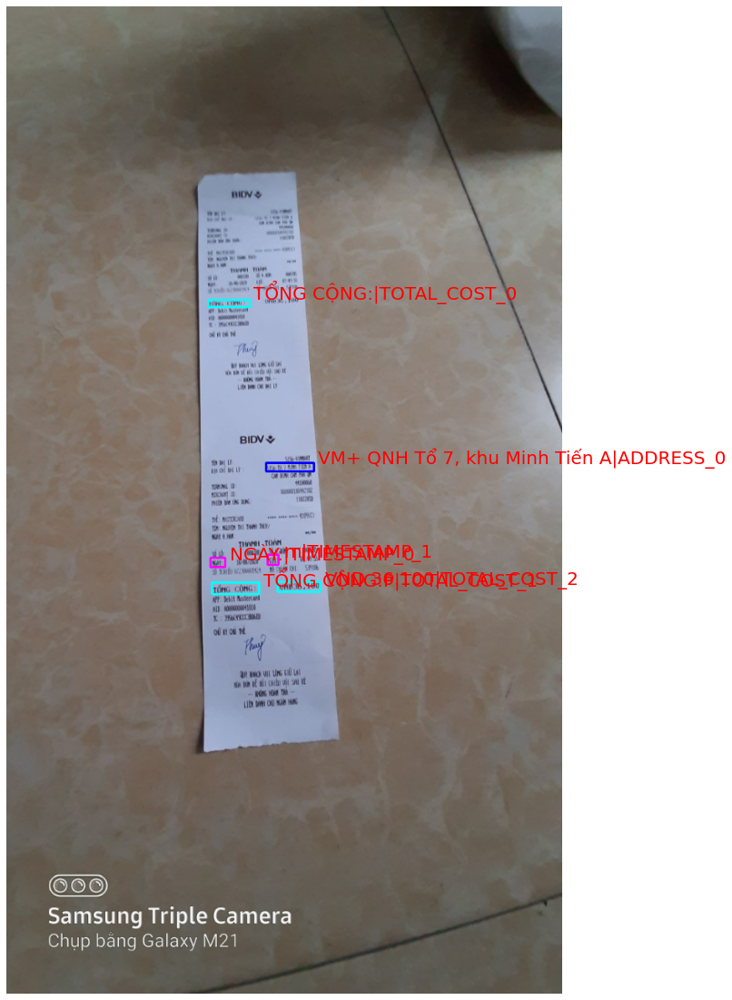

mcocr_public_145014avkgm.jpg


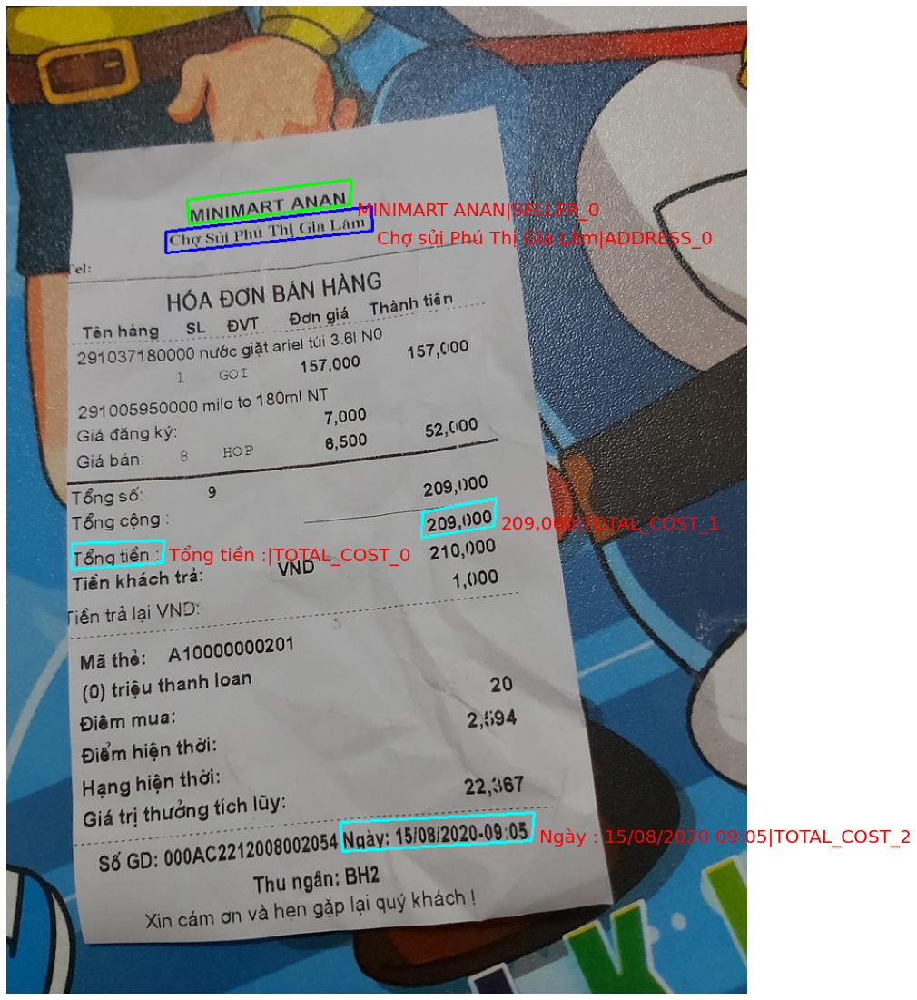

mcocr_public_145014yhorz.jpg


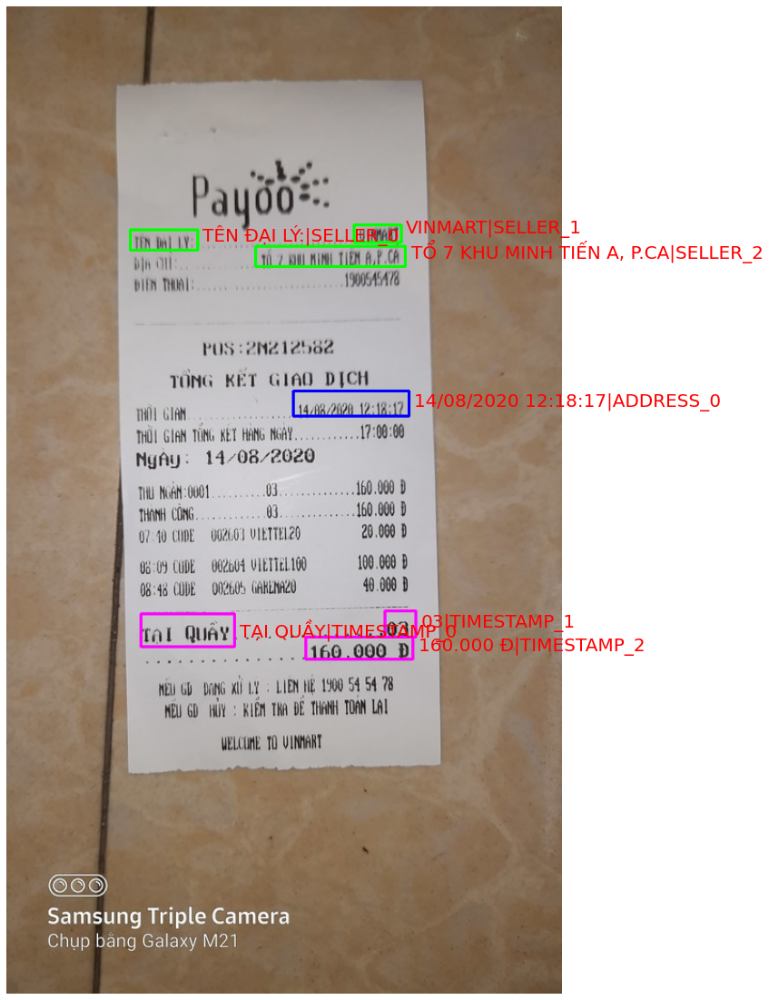

mcocr_public_145014quwvb.jpg


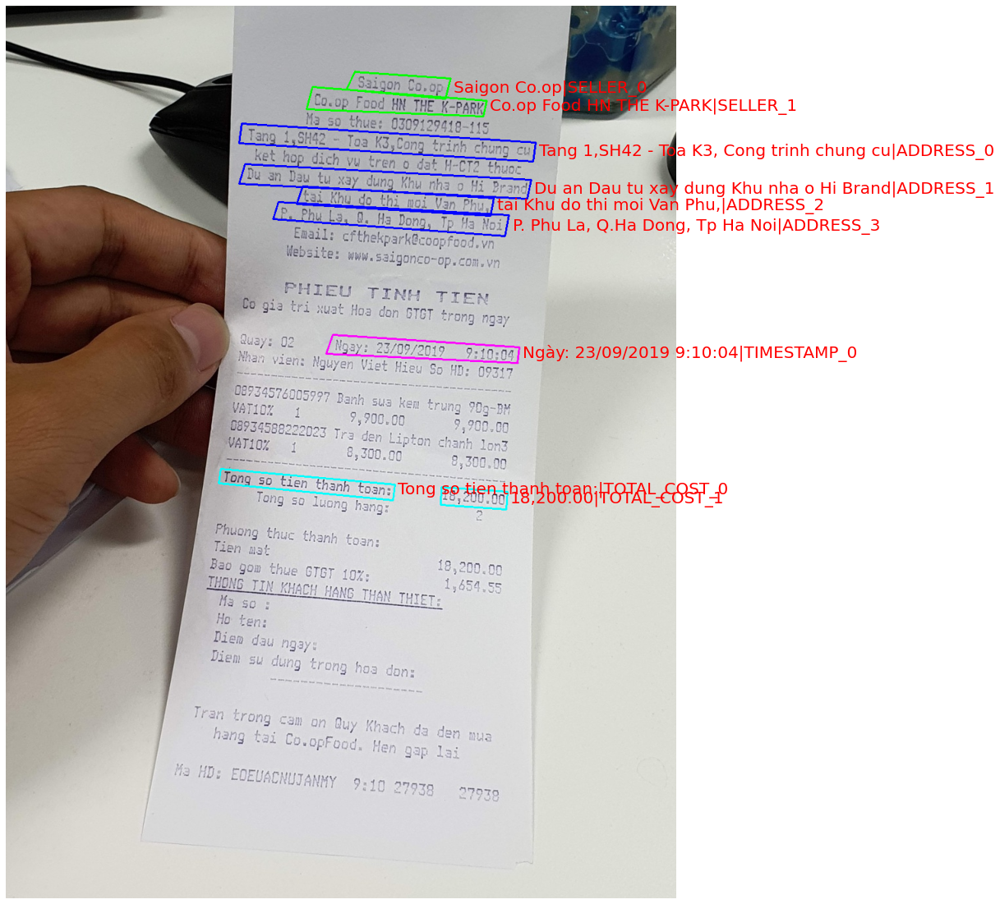

mcocr_public_145014bxkli.jpg


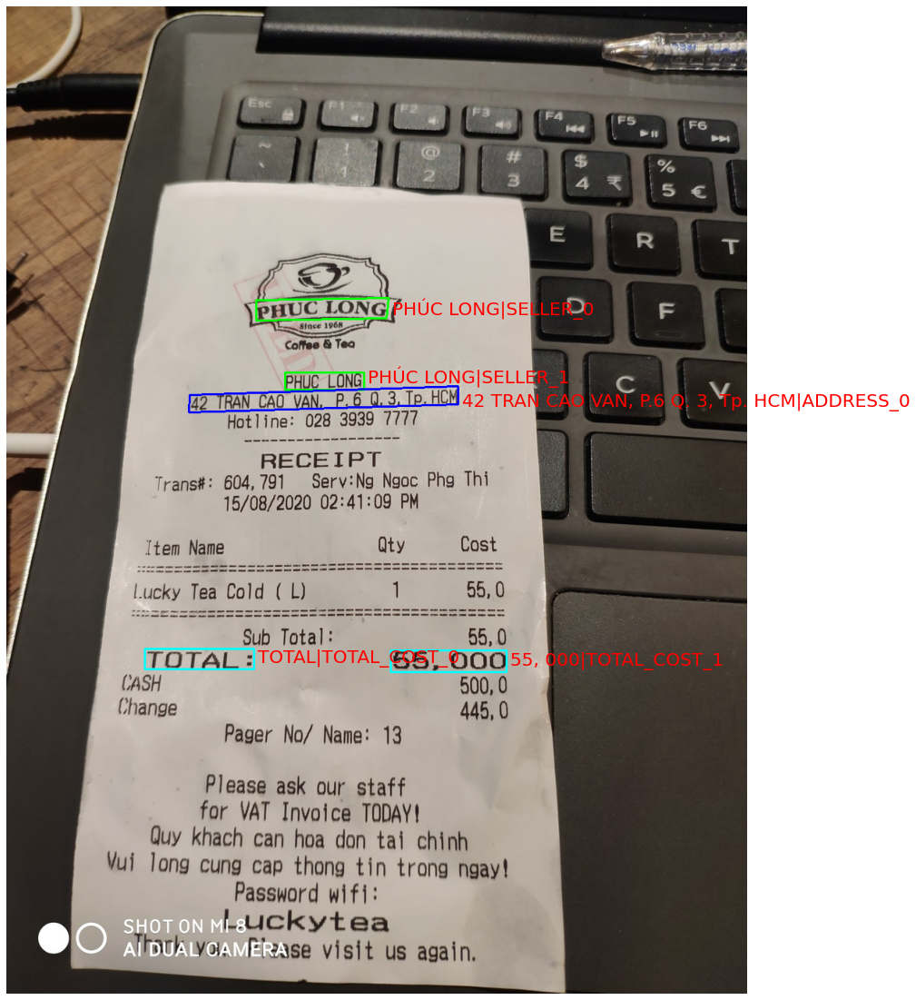

In [176]:
# Some samples on dataset has misannotation, missing annotation
noisy_examples = ["mcocr_public_145014mwhyh.jpg", "mcocr_public_145013clltn.jpg", "mcocr_public_145013uqtmx.jpg", 
"mcocr_public_145013cgpoh.jpg",
"mcocr_public_145014jizcq.jpg",
"mcocr_public_145014mwhyh.jpg",
"mcocr_public_145014sabav.jpg",
"mcocr_public_145014hpkhf.jpg",
"mcocr_public_145014avkgm.jpg",
"mcocr_public_145014yhorz.jpg",
"mcocr_public_145014quwvb.jpg",
"mcocr_public_145014bxkli.jpg"]

for file_name in noisy_examples:
    my_visualize(f"{train_dir}/train_images", file_name, train_anns, add_key_to_value=True)